# Análisis exploratorio de datos
Este notebook analiza las respuesta a una encuesta aplicada los consumidores de un Starbucks en Malasia.

In [1]:
#!pip install dataprep
#!pip install pandas-profiling

In [2]:
import pandas as pd
from dataprep.datasets import load_dataset
from dataprep.eda import create_report
from dataprep.eda import plot, plot_correlation, plot_missing

NumExpr defaulting to 8 threads.


In [3]:
df = pd.read_csv('../Datos/Starbucks_survey.csv')

In [4]:
rename_dict = {
    '1. Your Gender' : 'Gender',
    '2. Your Age' : 'Age',     
    '3. Are you currently....?' : 'Profession',
    '4. What is your annual income?' : 'Income',
    '5. How often do you visit Starbucks?' : 'Visit Frequency',
    '6. How do you usually enjoy Starbucks?' : 'Prefered Form of Consumption',
    '7. How much time do you normally  spend during your visit?' : 'Time Spent on Visit',
    "8. The nearest Starbucks's outlet to you is...?" : 'Distance to Store',
    '9. Do you have Starbucks membership card?' : 'Membership',
    '10. What do you most frequently purchase at Starbucks?' : 'Most consumed Product',
    '11. On average, how much would you spend at Starbucks per visit?' : 'Spend per Visit',
    '12. How would you rate the quality of Starbucks compared to other brands (Coffee Bean, Old Town White Coffee..) to be:' : 'Quality Rate',
    '13. How would you rate the price range at Starbucks?' : 'Price Range Rate',
    '14. How important are sales and promotions in your purchase decision?' : 'Sales and Promotion Importance',
    '15. How would you rate the ambiance at Starbucks? (lighting, music, etc...)' : 'Ambiance Rate',
    '16. You rate the WiFi quality at Starbucks as..' : 'WiFi Quality Rate',
    '17. How would you rate the service at Starbucks? (Promptness, friendliness, etc..)' : 'Service Rate',
    '18. How likely you will choose Starbucks for doing business meetings or hangout with friends?' : 'Likely for Meetings or Hangouts',
    '19. How do you come to hear of promotions at Starbucks? Check all that apply.' : 'Form of communication to Promotions',
    '20. Will you continue buying at Starbucks?' : 'Recurrent Costumer'
}

df = df.rename(rename_dict,axis=1)
df.head()


,Timestamp,Gender,Age,Profession,Income,Visit Frequency,Prefered Form of Consumption,Time Spent on Visit,Distance to Store,Membership,...,Spend per Visit,Quality Rate,Price Range Rate,Sales and Promotion Importance,Ambiance Rate,WiFi Quality Rate,Service Rate,Likely for Meetings or Hangouts,Form of communication to Promotions,Recurrent Costumer
0,2019/10/01 12:38:43 PM GMT+8,Female,From 20 to 29,Student,"Less than RM25,000",Rarely,Dine in,Between 30 minutes to 1 hour,within 1km,Yes,...,Less than RM20,4,3,5,5,4,4,3,Starbucks Website/Apps;Social Media;Emails;Dea...,Yes
1,2019/10/01 12:38:54 PM GMT+8,Female,From 20 to 29,Student,"Less than RM25,000",Rarely,Take away,Below 30 minutes,1km - 3km,Yes,...,Less than RM20,4,3,4,4,4,5,2,Social Media;In Store displays,Yes
2,2019/10/01 12:38:56 PM GMT+8,Male,From 20 to 29,Employed,"Less than RM25,000",Monthly,Dine in,Between 30 minutes to 1 hour,more than 3km,Yes,...,Less than RM20,4,3,4,4,4,4,3,In Store displays;Billboards,Yes
3,2019/10/01 12:39:08 PM GMT+8,Female,From 20 to 29,Student,"Less than RM25,000",Rarely,Take away,Below 30 minutes,more than 3km,No,...,Less than RM20,2,1,4,3,3,3,3,Through friends and word of mouth,No
4,2019/10/01 12:39:20 PM GMT+8,Male,From 20 to 29,Student,"Less than RM25,000",Monthly,Take away,Between 30 minutes to 1 hour,1km - 3km,No,...,Around RM20 - RM40,3,3,4,2,2,3,3,Starbucks Website/Apps;Social Media,Yes


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 122 entries, 0 to 121
Data columns (total 21 columns):
 #   Column                               Non-Null Count  Dtype 
---  ------                               --------------  ----- 
 0   Timestamp                            122 non-null    object
 1   Gender                               122 non-null    object
 2   Age                                  122 non-null    object
 3   Profession                           122 non-null    object
 4   Income                               122 non-null    object
 5   Visit Frequency                      122 non-null    object
 6   Prefered Form of Consumption         121 non-null    object
 7   Time Spent on Visit                  122 non-null    object
 8   Distance to Store                    122 non-null    object
 9   Membership                           122 non-null    object
 10  Most consumed Product                122 non-null    object
 11  Spend per Visit                      122 non-

In [6]:
#Revisamos el porcentaje de datos son nulos
df.isnull().sum()/(df.shape[0]/100)

Timestamp                              0.000000
Gender                                 0.000000
Age                                    0.000000
Profession                             0.000000
Income                                 0.000000
Visit Frequency                        0.000000
Prefered Form of Consumption           0.819672
Time Spent on Visit                    0.000000
Distance to Store                      0.000000
Membership                             0.000000
Most consumed Product                  0.000000
Spend per Visit                        0.000000
Quality Rate                           0.000000
Price Range Rate                       0.000000
Sales and Promotion Importance         0.000000
Ambiance Rate                          0.000000
WiFi Quality Rate                      0.000000
Service Rate                           0.000000
Likely for Meetings or Hangouts        0.000000
Form of communication to Promotions    0.819672
Recurrent Costumer                     0

In [7]:
df = df.dropna()

In [8]:
df_ = df.drop(['Timestamp'], axis=1)

In [9]:
df_

,Gender,Age,Profession,Income,Visit Frequency,Prefered Form of Consumption,Time Spent on Visit,Distance to Store,Membership,Most consumed Product,Spend per Visit,Quality Rate,Price Range Rate,Sales and Promotion Importance,Ambiance Rate,WiFi Quality Rate,Service Rate,Likely for Meetings or Hangouts,Form of communication to Promotions,Recurrent Costumer
0,Female,From 20 to 29,Student,"Less than RM25,000",Rarely,Dine in,Between 30 minutes to 1 hour,within 1km,Yes,Coffee,Less than RM20,4,3,5,5,4,4,3,Starbucks Website/Apps;Social Media;Emails;Dea...,Yes
1,Female,From 20 to 29,Student,"Less than RM25,000",Rarely,Take away,Below 30 minutes,1km - 3km,Yes,Cold drinks;Pastries,Less than RM20,4,3,4,4,4,5,2,Social Media;In Store displays,Yes
2,Male,From 20 to 29,Employed,"Less than RM25,000",Monthly,Dine in,Between 30 minutes to 1 hour,more than 3km,Yes,Coffee,Less than RM20,4,3,4,4,4,4,3,In Store displays;Billboards,Yes
3,Female,From 20 to 29,Student,"Less than RM25,000",Rarely,Take away,Below 30 minutes,more than 3km,No,Coffee,Less than RM20,2,1,4,3,3,3,3,Through friends and word of mouth,No
4,Male,From 20 to 29,Student,"Less than RM25,000",Monthly,Take away,Between 30 minutes to 1 hour,1km - 3km,No,Coffee;Sandwiches,Around RM20 - RM40,3,3,4,2,2,3,3,Starbucks Website/Apps;Social Media,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117,Male,40 and above,Self-employed,"RM25,000 - RM50,000",Monthly,Dine in,Between 1 hour to 2 hours,1km - 3km,Yes,Coffee,Around RM20 - RM40,3,3,5,3,2,4,4,Starbucks Website/Apps;Social Media,Yes
118,Male,From 20 to 29,Employed,"Less than RM25,000",Monthly,Dine in,Between 1 hour to 2 hours,1km - 3km,Yes,Coffee;Cold drinks;Juices;Pastries;Sandwiches,More than RM40,5,5,5,5,5,5,5,Starbucks Website/Apps;Social Media;Emails;Dea...,Yes
119,Male,From 20 to 29,Student,"Less than RM25,000",Rarely,Dine in,Between 30 minutes to 1 hour,1km - 3km,No,Coffee;Cold drinks,Less than RM20,3,2,4,3,3,3,4,Social Media;Through friends and word of mouth...,No
120,Female,From 20 to 29,Employed,"Less than RM25,000",Rarely,Take away,Below 30 minutes,within 1km,No,Coffee,Less than RM20,4,4,4,4,4,4,4,Social Media;Through friends and word of mouth...,Yes


  0%|          | 0/564 [00:00<?, ?it/s]


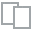
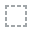
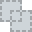
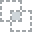
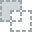
...
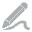
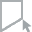
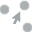
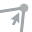
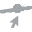

In [11]:
plot(df_)

  0%|          | 0/1880 [00:00<?, ?it/s]


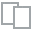
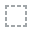
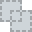
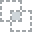
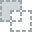
...
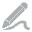
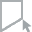
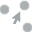
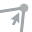
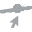

In [12]:
create_report(df).show()